# Atividade RF2.1.5 e 2.1.6

Carregar logs no formato .csv com a identificação da coluna correspondente ao: Identificador do caso (demanda); Atividade; Recurso; Data de início da atividade; Data de fim da atividade; Cliente; Tipo de demanda

In [1]:
import os

import pm4py
import pandas as pd

## Importando o dataset

In [2]:
log_file_path = "../data/log_2_geral_datas_distribuidas.csv"

df = pd.read_csv(log_file_path, encoding = "utf-8")
df.head()

,tarefa,dt_inicio,demanda_id,cliente,tp_demanda,dt_fim
0,Estimar_Tamanho,2021-04-26 18:06:40,261,cliente1,evolutiva,2021-04-28 12:10:06
1,Validar_Requisitos,2021-04-26 18:11:42,261,cliente1,evolutiva,2021-04-28 01:56:57
2,Projetar_Arquitetura,2021-04-26 18:16:45,261,cliente1,evolutiva,2021-04-27 17:33:12
3,Projetar_Modelo_Dados,2021-04-26 18:21:46,261,cliente1,evolutiva,2021-04-30 13:58:17
4,Fisicalizar_Modelo_Dados,2021-04-26 18:26:47,261,cliente1,evolutiva,2021-04-30 14:33:04


## Adaptando nome das colunas para evidenciar o que é o que

In [3]:
df = df.rename(columns={"tarefa" : "concept:tarefa",
                        "dt_inicio" : "time:inicio",
                        "demanda_id" : "case:concept:demanda_id",
                        "cliente" : "case:cliente",
                        "tp_demanda" : "tp_demanda",
                        "dt_fim" : "dt_fim"})

## Carregando DataFrame no PM4PY

In [4]:
df = pm4py.format_dataframe(df, case_id='case:concept:demanda_id', 
                                activity_key='concept:tarefa', 
                                timestamp_key='time:inicio')

log = pm4py.convert_to_event_log(df) # Transformando em log

# DFG

## DFG de Frequência

In [6]:
frequency_dfg, start_activities, end_activities = pm4py.discover_dfg(log)
pm4py.view_dfg(frequency_dfg, start_activities, end_activities)

## DFG de Desempenho

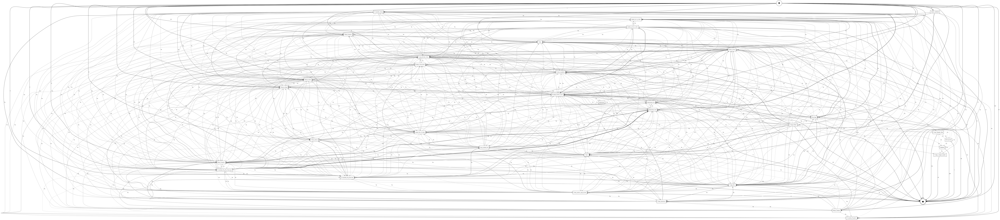

In [7]:
performance_dfg, start_activities, end_activities = pm4py.discover_performance_dfg(log)
pm4py.view_performance_dfg(performance_dfg, start_activities, end_activities)

## Salvando DFGs

In [8]:
pm4py.save_vis_dfg(frequency_dfg, start_activities, end_activities, '../sample_graphs/freq_dfg.svg')
pm4py.save_vis_performance_dfg(performance_dfg, start_activities, end_activities, '../sample_graphs/perf_dfg.svg')